<a href="https://colab.research.google.com/github/aks2093/EDA-on-image-data-for-Object-Detection/blob/master/eda_on_image_data_for_object_dection_and_localization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


Import required libraries and define paths

In [ ]:
import cv2
import os
import pandas as pd
import plotly.express as px

data_dir = "/content/drive/My Drive/smart_cow"
annotation_dir_path = os.path.join(data_dir, "WiderPerson", "Annotations")
images_dir_path = os.path.join(data_dir, "WiderPerson", "Images")
test_file_path = os.path.join(data_dir, "WiderPerson", "test.txt")
train_file_path = os.path.join(data_dir, "WiderPerson", "train.txt")
val_file_path = os.path.join(data_dir, "WiderPerson", "val.txt")


image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018242.jpg


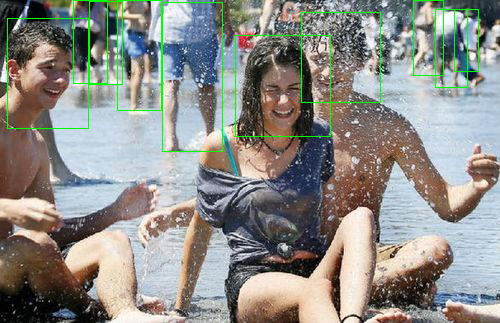



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018214.jpg


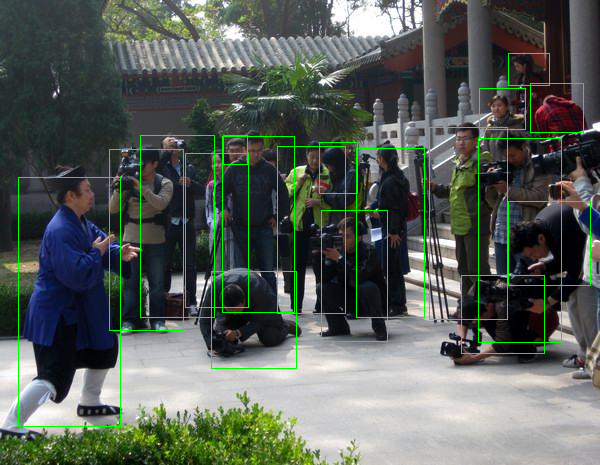



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018211.jpg


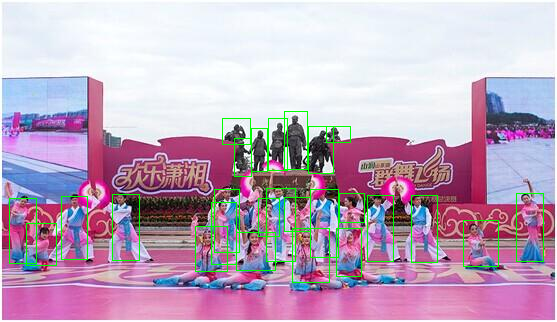



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018277.jpg


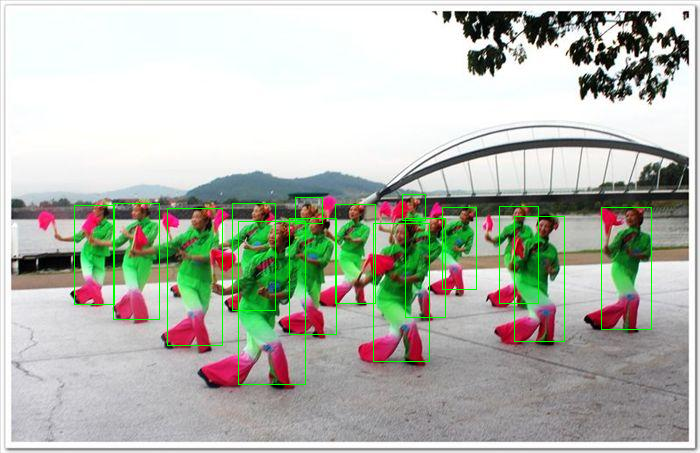



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018209.jpg


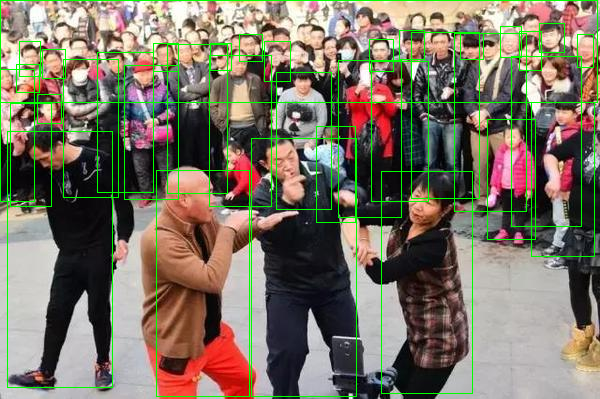



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018237.jpg


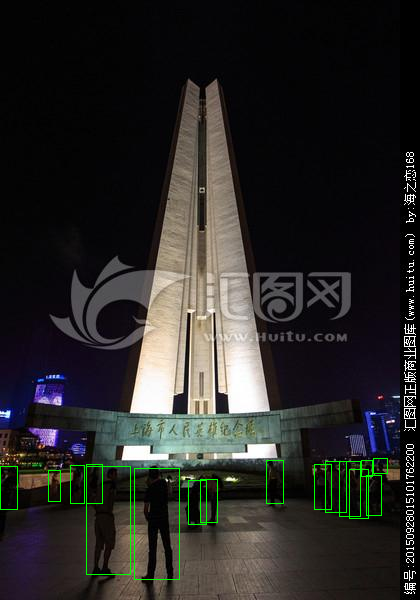



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018256.jpg


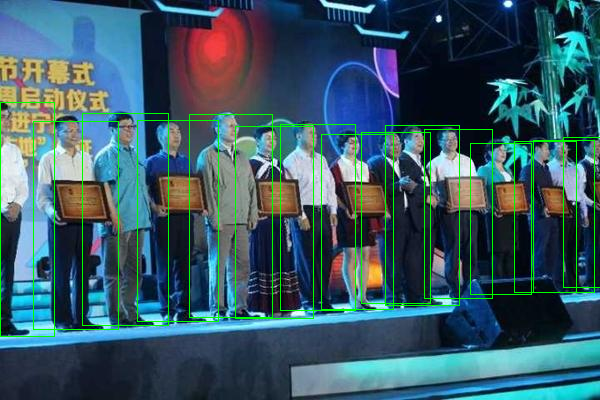



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018219.jpg


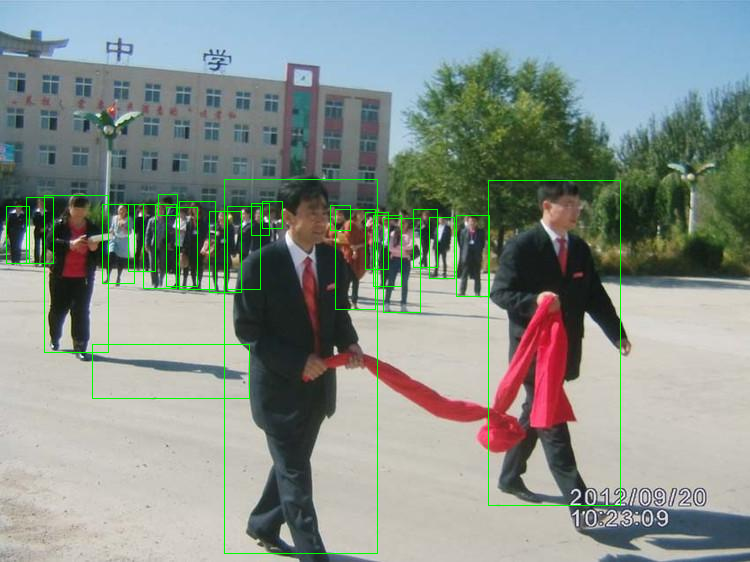



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018215.jpg


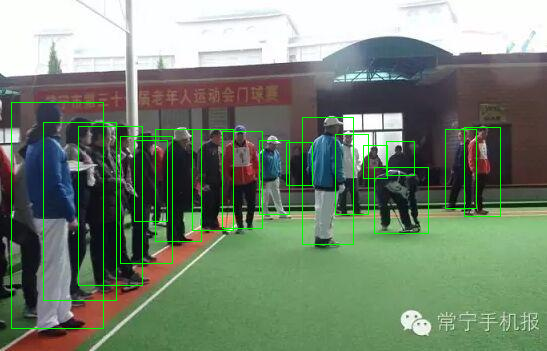



image_path: /content/drive/My Drive/smart_cow/WiderPerson/Images/018331.jpg


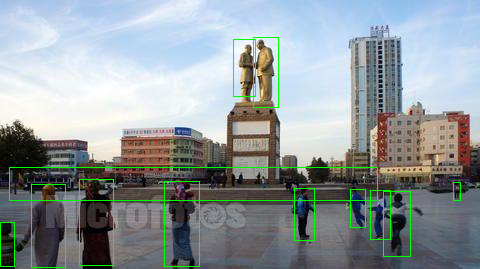

In [ ]:
color = (0, 255, 0)
thickness = 1
from google.colab.patches import cv2_imshow

num_of_images_to_print = 10 #maximum could be 9000
for annotation_file in os.listdir(annotation_dir_path):
    if num_of_images_to_print>0:
        image_name = annotation_file.split("/")[-1]
        image_path = os.path.join(images_dir_path, image_name).split(".txt")[0]
        img = cv2.imread(image_path)
        print("image_path: {}".format(image_path))
        annotation_file_path = os.path.join(annotation_dir_path, annotation_file)
        with open(annotation_file_path, "r") as annotation_fd:
            annotations = annotation_fd.readlines()
            num_of_annotations = int(annotations[0])
            for annotation in annotations[1:]:
                cls,x1,y1,x2,y2 = annotation.split(" ")
                cls,x1,y1,x2,y2 = int(cls),int(x1),int(y1),int(x2),int(y2.split("\n")[0])
                start_point = (x1,y1)
                end_point = (x2,y2)
                img = cv2.rectangle(img, start_point, end_point, color, thickness)
            cv2_imshow(img)
            print("\n")
            num_of_images_to_print -= 1
            # cv2.waitKey(0)
    else:
        break


In [ ]:
annotation_df = pd.DataFrame(columns = ["image_path","class","x1","y1","x2","y2","number_of_annotations"])

for annotation_file in os.listdir(annotation_dir_path):
    intermediate_dict = {}
    image_name = annotation_file.split("/")[-1]
    image_path = os.path.join(images_dir_path, image_name).split(".txt")[0]
    intermediate_dict["image_path"] = image_path
    annotation_file_path = os.path.join(annotation_dir_path, annotation_file)
    with open(annotation_file_path) as annotation_fd:
        annotations = annotation_fd.readlines()
        num_of_annotations = int(annotations[0])
        intermediate_dict["number_of_annotations"] = num_of_annotations
        for annotation in annotations[1:]:
            cls,x1,y1,x2,y2 = annotation.split(" ")
            cls,x1,y1,x2,y2 = int(cls),int(x1),int(y1),int(x2),int(y2.split("\n")[0])
            intermediate_dict["class"] = cls
            intermediate_dict["x1"] = x1
            intermediate_dict["y1"] = y1
            intermediate_dict["x2"] = x2
            intermediate_dict["y2"] = y2
            annotation_df = annotation_df.append(intermediate_dict, ignore_index=True)

annotation_df.to_csv(os.path.join(data_dir, "annotation_df.csv"), index=False)      


In [ ]:
annotation_df = pd.read_csv(os.path.join(data_dir, "annotation_df.csv"))
print(annotation_df.__len__())

class_map = {1: "pedestrians", 2:"riders", 3:"partially-visible persons", 4:"ignore regions", 5:"crowd"}

num_of_classes = annotation_df["class"].unique().__len__()
print("Number of classes: {}".format(num_of_classes))
annotation_df["class"] = annotation_df["class"].apply(lambda x:class_map[x])
classes = annotation_df["class"].unique()
print("classes: {}".format(classes))

annotation_df["x1y1x2y2"] = annotation_df["x1"].astype(str)+annotation_df["y1"].astype(str)+annotation_df["x2"].astype(str)+annotation_df["y2"].astype(str)
# print(annotation_df.groupby(["class"])["image_path"].count())
# print(annotation_df["image_path"].unique().__len__())
# print(annotation_df.groupby(["class"])["image_path"].nunique().to_dict())

images_per_class = annotation_df.groupby(["class"])["image_path"].nunique().to_dict()
annotations_per_class = annotation_df.groupby(["class"])["x1y1x2y2"].count().to_dict()
annotations_per_image = annotation_df.groupby(["image_path"])["x1y1x2y2"].count().to_dict()



273475
Number of classes: 5
classes: ['pedestrians' 'partially-visible persons' 'ignore regions' 'crowd'
 'riders']


In [ ]:
print("Images per class: {}".format(images_per_class))
print("Annotations per class: {}".format(annotations_per_class))
print("Annotations per image: {}".format(annotations_per_image))

Images per class: {'crowd': 3021, 'ignore regions': 811, 'partially-visible persons': 6861, 'pedestrians': 8975, 'riders': 357}
Annotations per class: {'crowd': 9640, 'ignore regions': 3649, 'partially-visible persons': 79934, 'pedestrians': 178593, 'riders': 1659}
Annotations per image: {'/content/drive/My Drive/smart_cow/WiderPerson/Images/000040.jpg': 35, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000041.jpg': 147, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000042.jpg': 24, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000044.jpg': 34, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000045.jpg': 16, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000046.jpg': 49, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000048.jpg': 38, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000049.jpg': 36, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000050.jpg': 18, '/content/drive/My Drive/smart_cow/WiderPerson/Images/000051.jpg': 27,

In [ ]:
classes=list(images_per_class.keys())
image_count = list(images_per_class.values())
fig = px.bar(x=classes, y=image_count, labels={'x':'class', 'y':"image_count"})
fig.show()

In [ ]:

classes=list(annotations_per_class.keys())
annotation_count = list(annotations_per_class.values())

fig = px.bar(x=classes, y=annotation_count, labels={'x':'class', 'y':"annotation_count"})

fig.show()

In [ ]:
# Plot a line graph for height and width of the images
image_df= pd.DataFrame(columns=["image_path", "height", "width"])

height = []
width = []
for annotation_file in os.listdir(annotation_dir_path):
    image_name = annotation_file.split("/")[-1]
    image_path = os.path.join(images_dir_path, image_name).split(".txt")[0]
    img = cv2.imread(image_path)
    height.append(img.shape[0])
    width.append(img.shape[1])
    image_df = image_df.append({"image_path":image_path, "height":img.shape[0], "width":img.shape[1]}, ignore_index = True)

image_df.to_csv(os.path.join(data_dir, "image_df.csv"), index=False) 


In [ ]:
# import plotly.express as px
image_df = pd.read_csv(os.path.join(data_dir, "image_df.csv"))

# fig = px.line(image_df[:100], y="height")
# fig.add_line(image_df[:100], y="width",)
# fig.show()

import plotly.graph_objects as go
image_df["image_path"] = image_df["image_path"].apply(lambda x:x.split("/")[-1])
fig = go.Figure()
fig.add_trace(go.Scatter(x = image_df[:500]["image_path"], y=image_df[:500]["height"], mode='lines', name='height'))
fig.add_trace(go.Scatter(x = image_df[:500]["image_path"], y=image_df[:500]["width"], mode='lines', name='width'))

fig.show()

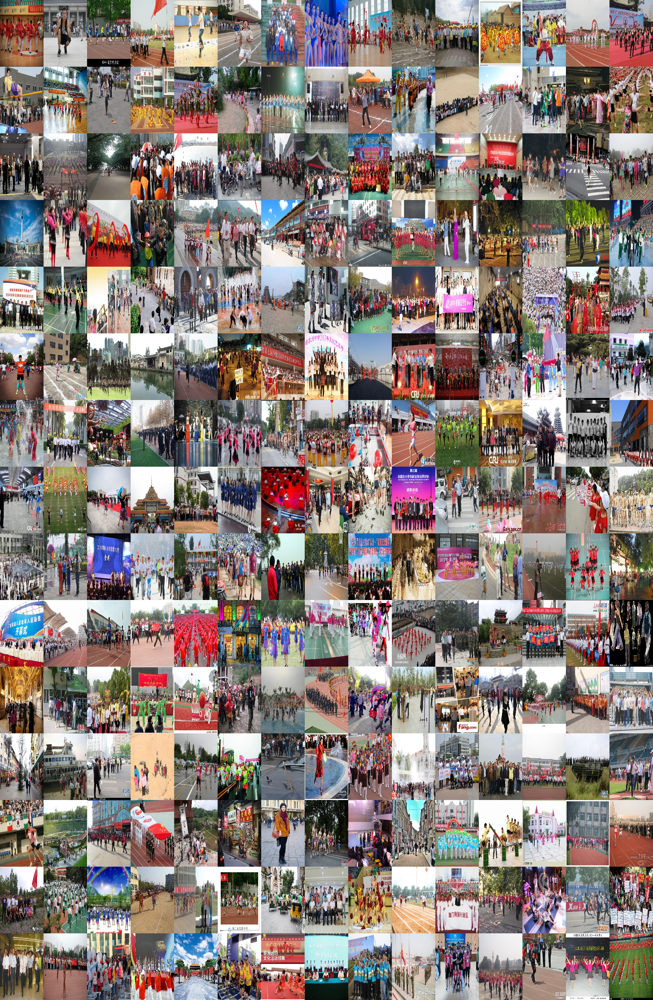

In [ ]:
from imutils import build_montages
image_df = pd.read_csv(os.path.join(data_dir, "image_df.csv"))
image_df = image_df.sample(frac=1).reset_index(drop=True)

sample = image_df[:225]
images_paths = sample["image_path"].to_list()

images = []

for image_path in images_paths:
    image = cv2.imread(image_path)
    images.append(image)

montages = build_montages(images, (128, 196), (15, 15))
for montage in montages:
	cv2_imshow(montage)
	# cv2.waitKey(0)

In [ ]:
import numpy as np
import imgaug as ia
import imgaug.augmenters as iaa
import cv2
from google.colab.patches import cv2_imshow

# images = np.zeros((2, 128, 128, 3), dtype=np.uint8)  # two example images

# images[:, 64, 64, :] = 255
# bbs = [
#     [ia.BoundingBox(x1=10.5, y1=15.5, x2=30.5, y2=50.5)],
#     [ia.BoundingBox(x1=10.5, y1=20.5, x2=50.5, y2=50.5),
#      ia.BoundingBox(x1=40.5, y1=75.5, x2=70.5, y2=100.5)]
# ]

# seq = iaa.Sequential([
#     iaa.AdditiveGaussianNoise(scale=0.05*255),
#     iaa.Affine(translate_px={"x": (1, 5)})
# ])

# images_aug, bbs_aug = seq(images=images, bounding_boxes=bbs)
# start_point = (10,15)
# end_point = (30,50)
# color = (0, 255, 0)
# img = cv2.rectangle(images[0], start_point, end_point, (0,255,0), 1)
# img = cv2.rectangle(images[0], (10,20), (50, 50) ,(0,255,0), 1)
# cv2_imshow(images[0])
# print(bbs_aug)
# cv2_imshow(images_aug[0])



image_df = pd.read_csv(os.path.join(data_dir, "image_df.csv"))
# image_df = image_df.sample(frac=1).reset_index(drop=True)
annotation_df = pd.read_csv(os.path.join(data_dir, "annotation_df.csv"))
image_path = image_df[:1]["image_path"].values[0]
print(image_path)
annoatations = annotation_df[annotation_df["image_path"]==image_path]

print(annoatations[["x1","y1","x2","y2"]])


/content/drive/My Drive/smart_cow/WiderPerson/Images/018242.jpg
    x1  y1   x2   y2
0  162   2  222  151
1  117   0  161  110
2   73   0  107   83
3   89   1  122   84
4  413   0  443   75
5  435   9  467   87
6  454   9  478   71
7    7  18   88  128
8  235  35  330  136
9  301  12  380  102


(323, 500, 3)


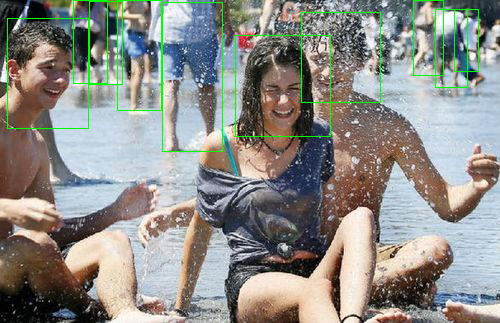

97 2 133 140
[BoundingBox(x1=97.2000, y1=1.8576, x2=133.2000, y2=140.2477, label=None), BoundingBox(x1=70.2000, y1=0.0000, x2=96.6000, y2=102.1672, label=None), BoundingBox(x1=43.8000, y1=0.0000, x2=64.2000, y2=77.0898, label=None), BoundingBox(x1=53.4000, y1=0.9288, x2=73.2000, y2=78.0186, label=None), BoundingBox(x1=247.8000, y1=0.0000, x2=265.8000, y2=69.6594, label=None), BoundingBox(x1=261.0000, y1=8.3591, x2=280.2000, y2=80.8050, label=None), BoundingBox(x1=272.4000, y1=8.3591, x2=286.8000, y2=65.9443, label=None), BoundingBox(x1=4.2000, y1=16.7183, x2=52.8000, y2=118.8854, label=None), BoundingBox(x1=141.0000, y1=32.5077, x2=198.0000, y2=126.3158, label=None), BoundingBox(x1=180.6000, y1=11.1455, x2=228.0000, y2=94.7368, label=None)]


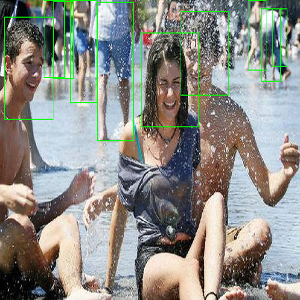

In [ ]:
bbs = []
img = cv2.imread(image_path)
print(img.shape)
for index, row in annoatations[["x1","y1","x2","y2"]].iterrows():
    start_point = (int(row["x1"]), int(row["y1"]))
    end_point = (int(row["x2"]), int(row["y2"]))
    img = cv2.rectangle(img, start_point, end_point, color, 1)
    bbs.append(ia.BoundingBox(x1=row["x1"], y1=row["y1"], x2=row["x2"], y2=row["y2"]))

cv2_imshow(img)

seq = iaa.Sequential([
    iaa.Resize({"height": 300, "width": 300})
])

images_aug, bbs_aug = seq(images=[img], bounding_boxes=bbs)
# print(images_aug[0])
print(bbs_aug[0].x1_int,bbs_aug[0].y1_int, bbs_aug[0].x2_int, bbs_aug[0].y2_int)
print(bbs_aug)
cv2_imshow(images_aug[0])

In [ ]:
class_annotation_dict = {}
class_image_dict = {}

for annotation_file in os.listdir(annotation_dir_path):
    image_name = annotation_file.split("/")[-1]
    image_path = os.path.join(images_dir_path, image_name).split(".txt")[0]
    annotation_file_path = os.path.join(annotation_dir_path, annotation_file)
    class_ = list()
    with open(annotation_file_path, "r") as annotation_fd:
        annotations = annotation_fd.readlines()
        num_of_annotations = int(annotations[0])
        for annotation in annotations[1:]:
            cls,x1,y1,x2,y2 = annotation.split(" ")
            cls,x1,y1,x2,y2 = int(cls),int(x1),int(y1),int(x2),int(y2.split("\n")[0])
            if  cls not in class_:
                class_.append(cls)
            if cls not in class_annotation_dict:
                class_annotation_dict[cls] = 1
            else:
                class_annotation_dict[cls] += 1
    for cls in class_:
        if cls not in class_image_dict:
            class_image_dict[cls] = 1
        else:
            class_image_dict[cls] += 1


print(class_annotation_dict)
print(class_image_dict)
